# **Seminar 2 - units 7 (community detection) and 8 (graph diffusion)**

---

**Course**: Graphs and Network Analysis

**Degree**: Artificial Intelligence

**Content**: Practical seminar with exercises of the units 7 and 8.

**Description of the activity**: In this seminar we will put into practice the knowledge of the topics of communities and graph diffusion. We will work with two different sets of data. First, we will practice the theme of communities with data extracted from Spotify. Regarding the topic of graph diffusion, we will work with real data on the impact of COVID-19 in Spanish provinces over a period of time.


## Assessment

---

**Final submission**: You will have to deliver a Colab '.ipynb' file corresponding to each group (you can do the exercise individually or in groups of 2 people). To get the file go to File --> Download. You have to answer and analyze the different problems. The programming code will NOT be evaluated but how the problem was solved and reasoned. So the "report" will consist in the results generated by the execution of the various cells where you write the code AND the comments you write there. We recommend that for each part of the exercise that requires an explanation, insert a text cell with this short dscription. No need for long explanations, if the exercise is to call a NetworkX function, the code is self-explanatory, but in the exercises where you have to program a little of code, you may need to reason about the obtained results.

When submitting the '.ipynb' file, **keep the output of the execution with the results visible**.

**Submission form**: The delivery will be made through the Virtual Campus. You will need to upload it through the submission resource set up there. If there is more than one person in the group, it is enough for one of you to make the submission. Don't forget to put the name of the group members in the given colab code.

**Doubts**: For any doubts you can contact Josep.Llados@uab.cat.

**Submission dadline**: Monday **May 19** (included).

## Credit

---

This activity was originally designed by Adrià Molina.

## Materials

---

You will find code examples in the Google Colab notebooks for units 7 and 8 (you will find the links in the Virtual Campus).


**<font color='red'>!!! DON'T FORGET TO FILL IN THE FOLLOWING INFORMATION IN YOUR SUBMISSION FILE !!!</font>**`
---

# Authors

**Lab group:**

**Student 1 - X**

**Student 2 - Y**

## Working framework preparation
----

The main libraries that will be used in this seminar are the following:

* [NetworkX](https://networkx.github.io/)
* [Pandas](https://pandas.pydata.org/)
* [Geopandas](https://geopandas.org/)
* [Matplotlib](https://matplotlib.org/)
* [NumPy](https://numpy.org/)

First we create a directory where we will download a series of files with the data.

In [ ]:
####################################################################################
#### WARNING (NOV 2022 --> There is a bug in new version of NetworkX when calling scipy functions (within numpy), better to install NetworkX version 2.7)
#### This compatibility issue will probably be fixed in the future. It affects to the graph visualization functions.
#### RUN this cell in case you have errors when visualizing the graph
####################################################################################
#!pip install 'scipy>=1.8'
#!pip install 'networkx<2.7'

In [ ]:
!mkdir data_generated
!pip install geopandas
!pip install libpysal

#   Provincias españolas - Data in CSV format
#   translate_clean.csv --> Codes of provinces
#   provincias-espanolas.geojson --> polygon information to draw the map
#   graph.ml
#   casos_diagnostico_provincia.csv --> information of infections per province

!git clone https://github.com/EauDeData/data_for_seminars.git
!cp data_for_seminars/* data_for_seminars/../
!rm -rf ./data_for_seminars/

Cloning into 'data_for_seminars'...
remote: Enumerating objects: 25, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 25 (delta 8), reused 2 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (25/25), 1.29 MiB | 4.51 MiB/s, done.
Resolving deltas: 100% (8/8), done.


Packages import.

In [ ]:
import networkx as nx
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas
from libpysal import weights
import copy
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline
from matplotlib.animation import FuncAnimation
from scipy.interpolate import make_interp_spline, BSpline

# UNIT 7 - COMMUNITY DETECTION

---



In this use case we can choose one of the three following graphs:

* LoveOfLesbian_1389
* Blackpink_2997
* BadBunny_1814

The three graphs are constructed from different Spotify artists; which represent the nodes. Depending on whether two artists have worked together or not, an edge is placed with weight equal to the number of times they have collaborated.
The name of the graph (the three above) indicates the node from which artists have started to be explored and the number of nodes. You can use the one you prefer. For example *LoveOfLesbian_1389* means that the node from which Spotify has been explored is *Love of Lesbian* and this graph has 1389 nodes.

Using different seed nodes in exploration gives access to different communities within the music industry. Some information of interest to choose the graph can be:


    LoveOfLesbian_1389: Spanish pop/rock/indie industry
    Blackpink_2997 International mainstream pop industry
    BadBunny_1814 Urban music industry (International and Hispanic)

The three graphs are not disjoint. The intersection, or the union, could be generated. Below is the code to do the intersection of the node sets of the three graphs.

If you want to generate a graph from a different artist, you can find the script in the [github repository](https://github.com/EauDeData/data_for_seminars) but you will need some runtime and [Spotify developer ](https://developer.spotify. com/dashboard/login)


In [ ]:
getset = lambda x: set(x.nodes())

graf1 = getset(nx.read_gexf('LoveOfLesbian_1389.gexf'))

graf2 = getset(nx.read_gexf('Blackpink_2997.gexf'))

graf3 = getset(nx.read_gexf('BadBunny_1814.gexf'))

#Intersection of the node sets of the three graphs
print("Number of common nodes of the intersection: ",len(graf3.intersection(graf2, graf1)))


Number of common nodes of the intersection:  25


Reading the data (xtension ```gexf```). You can use any of the three graphs. We use the variable **graf** to assign the selected graph.

In [ ]:
# If we want a different graph, change the variablee "nom"
# nom = 'Blackpink_2997.gexf'
# nom = 'BadBunny_1814.gexf'
nom = 'LoveOfLesbian_1389.gexf'
graf = nx.read_gexf(nom)

# Graph info
print(graf)

# If you want to show the information of the graph, uncomment the following line
#list(graf.edges.data())

# of if you want to see a particular edge ...
#list(graf.edges.data())[4]

Graph with 1389 nodes and 1696 edges


The *weight* we have in the data table is the inverse of the number of collaborations between two artists, so the number will be closer to 0 (less distance) as the collaborations increase. If we want to recover this aggregate, and assign it to the edges:

In [ ]:
edge_data = {(edge[0], edge[1]): 1/edge[2]['weight'] for edge in graf.edges.data()}
nx.set_edge_attributes(graf, edge_data, 'n_colaboracions')

Graph visualization.

In [ ]:
# graph visualization
plt.rcParams['figure.figsize'] = [100,100]
plt.rcParams['figure.dpi'] = 100
pos=nx.spring_layout(graf)
nx.draw_networkx(graf, pos=pos, with_labels=True, node_size=700)

Some artists have been detected, but not explored; which means we have a record of their existence but not a record of their collaborations.
Such data could not be considered in the graph.
The following function allows us to clean up these nodes.

In [ ]:
def clean_graph(graf):
  # Some artists have not been explored;
  # It is not representative that they don't have any connection;
  # If you want, you can clean up these nodes
  graph = copy.deepcopy(graf)
  delete = []
  dg = nx.degree(graph)
  for node in graph.nodes():
      if dg[node] == 1: delete.append(node)
  for i in delete:
    graph.remove_node(i)
  return graph

# EXERCISES TO SOLVE
* You have to answer the sections that start with a **bullet point**.

----

### Basic measures
* What is the [diameter](https://en.wikipedia.org/wiki/Six_degrees_of_separation) of the graph?


In [ ]:
# ANSWER
print("The diameter of the graph is", nx.diameter(graf))


The diameter of the graph is 6


What is the most important node of the whole graph?

In [ ]:
# ANSWER
degree_centrality = nx.degree_centrality(graf)
betweenness_centrality = nx.betweenness_centrality(graf)
closeness_centrality = nx.closeness_centrality(graf)
eigenvector_centrality = nx.eigenvector_centrality(graf)

measures = [degree_centrality, betweenness_centrality, closeness_centrality, eigenvector_centrality]
measure_names = ["degree", "betweenness", "closeness", "eigenvector"]

def get_top_node(dictionary):
    sorted_dict = dict(sorted(dictionary.items(), key=lambda item: item[1], reverse=True))
    top_node, top_value = next(iter(sorted_dict.items()))
    return top_node, top_value

for name, measure in zip(measure_names, measures):
    node, value = get_top_node(measure)
    print(f"The most important node by {name} centrality is '{node}' with a score of {value:.2f}")

The most important node by degree centrality is 'B-Real' with a score of 0.08
The most important node by betweenness centrality is 'Bunbury' with a score of 0.47
The most important node by closeness centrality is 'Bunbury' with a score of 0.38
The most important node by eigenvector centrality is 'Bunbury' with a score of 0.41


---

After looking at all the centrality measures (degree, betweenness, closeness, and eigenvector) we can conclude that 'Bunbury' is the node with the maximum centrality in almost all metrics. Therefore, this means that it is the most important and well-connected node in the graph.

---

## Clique detection
* What is the biggest clique of the graph?

In [ ]:
# ANSWER

maximum_clique = max(nx.find_cliques(graf), key=len)

In [ ]:
print(maximum_clique)

['Jaime Urrutia', 'Bunbury', 'Andrés Calamaro', 'Loquillo', 'Ariel Rot']


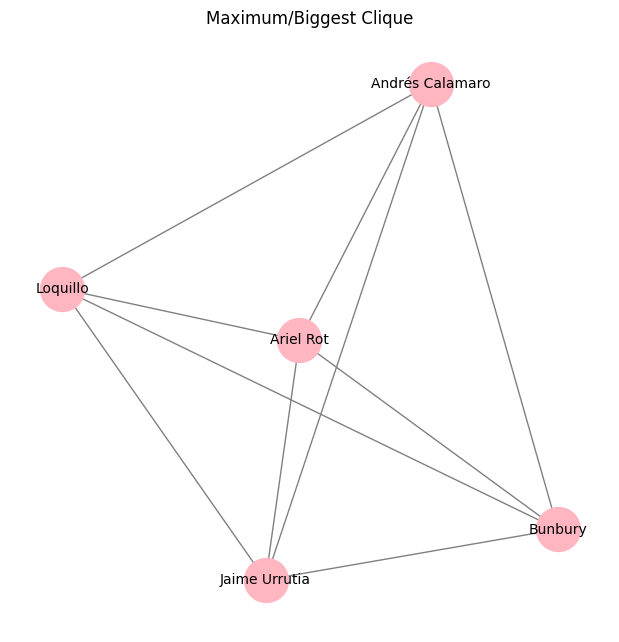

In [ ]:
# Create a subgraph with the nodes in the largest clique
clique_subgraph = graf.subgraph(maximum_clique)

# Draw the subgraph
plt.figure(figsize=(6, 6))
nx.draw(clique_subgraph, with_labels=True, node_color='lightpink', edge_color='gray', node_size=1000, font_size=10)
plt.title("Maximum/Biggest Clique")
plt.show()

* What is the most central artist of the maximum clique?

In [ ]:
# ANSWER

# CHECK DEGREE CENTRALITY

# Create a subgraph with the nodes in the maximum clique
clique_subgraph = graf.subgraph(maximum_clique)

centrality = nx.degree_centrality(clique_subgraph)

# Find the node with the highest degree centrality
max_centrality_node = max(centrality, key=centrality.get)
max_centrality_value = centrality[max_centrality_node]

# Print the result
print(centrality)

{'Andrés Calamaro': 1.0, 'Loquillo': 1.0, 'Bunbury': 1.0, 'Jaime Urrutia': 1.0, 'Ariel Rot': 1.0}


In [ ]:
# CHECK EIGENVECTOR CENTRALITY

# Create a subgraph with the nodes in the maximum clique
clique_subgraph = graf.subgraph(maximum_clique)

centrality = nx.eigenvector_centrality(clique_subgraph)

max_centrality_node = max(centrality, key=centrality.get)
max_centrality_value = centrality[max_centrality_node]

# Print the result
print(centrality)

{'Andrés Calamaro': 0.447213595499958, 'Loquillo': 0.447213595499958, 'Bunbury': 0.447213595499958, 'Jaime Urrutia': 0.447213595499958, 'Ariel Rot': 0.447213595499958}


---
In a clique, every node is connected to every other node, so they all have the same number of connections. Because of this, centrality measures like degree centrality and eigenvector centrality (which look at how well-connected a node is) give the same score to each node. That means all the nodes are seen as equally important within the clique, since no node stands out more than the others in terms of its connections. <br>
<br>
Another option, would be to consider the artist with more collaborations within the clique as the most central node:

---

In [ ]:
collaborations = {}

# Initialize collaboration counts
for node in clique_subgraph.nodes():
    collaborations[node] = 0

# Sum up collaboration values from edges
for u, v in clique_subgraph.edges():
    n_colabs = clique_subgraph[u][v].get('n_colaboracions', 0)
    collaborations[u] += n_colabs
    collaborations[v] += n_colabs

# Print the results
for name, value in collaborations.items():
    print(f"node: {name}, number of collaborations: {value}")

max_col = dict(sorted(collaborations.items(), key=lambda item: item[1], reverse=True))
top_node, top_value = next(iter(max_col.items()))

print("\n")
print(f"Most central artist in terms of collaborations: {top_node}")

node: Andrés Calamaro, number of collaborations: 22.0
node: Loquillo, number of collaborations: 16.0
node: Bunbury, number of collaborations: 20.0
node: Jaime Urrutia, number of collaborations: 12.0
node: Ariel Rot, number of collaborations: 6.0


Most central artist in terms of collaborations: Andrés Calamaro


* Which is the clique with the highest number of collaborations (on average)?

In [ ]:
# ANSWER
# Highest number of collaborations = The one that has more connections
maximal_cliques = list(nx.find_cliques(graf))

max_collaborations = 0
max_clique = None

# Check each clique
for clique in maximal_cliques:
    # Create a subgraph for the current clique
    clique_subgraph = graf.subgraph(clique)

    # Calculate the total number of collaborations (sum of n_colaboracions) in the clique
    total_collaborations = sum([graf[u][v]['n_colaboracions'] for u, v in clique_subgraph.edges()])

    if total_collaborations > max_collaborations:
        max_collaborations = total_collaborations
        max_clique = clique

print("The clique with the highest number of collaborations is:", max_clique)
print("Total number of collaborations (sum of n_colaboracions):", max_collaborations)


The clique with the highest number of collaborations is: ['Eliades Ochoa', 'Cuarteto Patria']
Total number of collaborations (sum of n_colaboracions): 95.0



---
To find the clique with the highest number of collaborations, we first use NetworkX's `find_cliques` function to identify all maximal cliques in the graph. Then, for each clique, we create a subgraph containing only the nodes and edges of that clique. We calculate the total number of collaborations by summing the `n_colaboracions` values from the general graph, using the edges of the subgraph. Finally, we update `max_collaborations` and `max_clique` to store the highest number of collaborations and the corresponding clique.

---


### Divisive Clustering: Girvan Newman clustering

At this point the algorithm to use is quite expensive, so we will use the reduced graph, eliminating the less representative nodes with the `clean_graph()` function defined earlier.

In NetworkX the algorithm *Girvan Newman* is implemented in the `community` package.

In [ ]:
graf = clean_graph(graf)

* Visualitzeu a través de l'algorisme de Girvan Newman l'evolució d'un artista central de l'apartat anterior durant les diferents particions.

> We want a `graphs` list that contains each of the subgraphs generated by the different levels of the `girvan_newman()` algorithm that contain the target node. Note that the clustering algorithm obtains, at each level, a partition of the graph into *n* subgraphs. One of these will contain the target node.

In [ ]:
# ANSWER
import itertools
import operator

target = 'Bunbury' # Name of the artist for which we want to see his/her evolution
graphs = [] # List of objects of type graph; representing the evolution of our node 'target'

evolution = nx.community.girvan_newman(graf)

for communities in itertools.islice(evolution, None):
    for community in communities:
        if target in community:
            # Create a subgraph from the community containing the target
            subgraph = graf.subgraph(community).copy()
            graphs.append(subgraph)


print(graphs)

[<networkx.classes.graph.Graph object at 0x7f4bbe894050>, <networkx.classes.graph.Graph object at 0x7f4bd93e8550>, <networkx.classes.graph.Graph object at 0x7f4bd9497f90>, <networkx.classes.graph.Graph object at 0x7f4bd8c2a790>, <networkx.classes.graph.Graph object at 0x7f4bd947d010>, <networkx.classes.graph.Graph object at 0x7f4bd6895150>, <networkx.classes.graph.Graph object at 0x7f4bd942c810>, <networkx.classes.graph.Graph object at 0x7f4bd9fc7dd0>, <networkx.classes.graph.Graph object at 0x7f4bd9f4e610>, <networkx.classes.graph.Graph object at 0x7f4c1bd3e110>, <networkx.classes.graph.Graph object at 0x7f4bbe896b50>, <networkx.classes.graph.Graph object at 0x7f4bd8c2b150>, <networkx.classes.graph.Graph object at 0x7f4bbe8fffd0>, <networkx.classes.graph.Graph object at 0x7f4bd917f390>, <networkx.classes.graph.Graph object at 0x7f4bdc6b0090>, <networkx.classes.graph.Graph object at 0x7f4bd9484910>, <networkx.classes.graph.Graph object at 0x7f4bdc6b3790>, <networkx.classes.graph.Graph 


---

To obtain a list of all the subgraphs (containing the target node) generated by the different stages of the Girvan-Newman algorithm, we first apply the *girvan_newman* function. This function returns an iterator over the communities formed at each step of the algorithm. Using *itertools.islice*, we iterate through each community generated at each step. If a community contains the target node, we create a subgraph of that community and append it to our list.

---


If our `graphs` list contains a sequence of Graph objects, corresponding to splits at different levels of the hierarchy, we can visualize this sequence to see how the community evolves around our target node. We give you a code to generates this visualization, from the list of graphs (You have generated previously the `graphs` variable):

In [ ]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

graphs = list(reversed(list(graphs)))
toKeep = []
for n,i in zip(range(len(graphs) - 1),graphs):
  if len(graphs[n]) != len(graphs[n+1]): toKeep.append(graphs[n])
  # Not all levels of the hierarchical algorithm vary the subgraph
  # of our target node; we remove this part for display convenience

def draw(i):
  nx.draw_networkx(toKeep[i])
  plt.show()
interact(draw, i=widgets.IntSlider(value = 0, max = len(toKeep)-1))


interactive(children=(IntSlider(value=0, description='i', max=16), Output()), _dom_classes=('widget-interact',…

<function __main__.draw(i)>

## K-Cores Clustering

* Find and visualize the k-Core graph that maximizes K.

In [ ]:
# ANSWER

# Compute core numbers of all nodes
core_numbers = nx.core_number(graf)

# Obtain the maximum k of all the core values
k_max = max(core_numbers.values())

In [ ]:
print("The largest k-Core corresponds to the k value of: ",k_max)
nx.draw_networkx(nx.k_core(graf, k_max))

The largest k-Core corresponds to the k value of:  5


* **Metrics**: Next to each  ```print``` write the call to the function to calculate the corresponding metric regarding the most central nodel, diameter, clustering coefficient, average connectivity...

In [ ]:
# ANSWER

def summary(graf):
  # We can prepare a summary() function with all the information we want to show from the graphs

  # Compute the node with highest degree centrality (most central node)
  degree_centrality = nx.degree_centrality(graf)
  degree_centrality = dict(sorted(degree_centrality.items(), key=lambda item: item[1], reverse=True))
  top_centrality_node, top_centrality_value = next(iter(degree_centrality.items()))

  print(f"Most central node: {top_centrality_node}")
  print(f"Diameter: {nx.diameter(graf)}")
  print(f"Avg. Cluster Coeficient: {nx.average_clustering(graf)}")
  print(f"Avg. Degree Connectivity: {nx.average_degree_connectivity(graf)}")
  print(f"Avg. Shortest Path: {nx.average_shortest_path_length(graf)}")


In [ ]:
graf_k_core = nx.k_core(graf, k_max)
summary(graf_k_core)

Most central node: Bunbury
Diameter: 3
Avg. Cluster Coeficient: 0.4366136279179757
Avg. Degree Connectivity: {9: 9.222222222222221, 10: 8.4, 7: 8.952380952380953, 5: 9.72, 12: 8.083333333333334, 8: 9.5625, 14: 8.392857142857142, 6: 9.5}
Avg. Shortest Path: 1.640316205533597


* Is the parameter `k` related to the average clustering coefficient of the core? Why?

In [ ]:
# This is the opposite of before, the k now is the minimum.
# Compute core numbers of all nodes
core_numbers = nx.core_number(graf)

# Obtain the min k of all the core values
k_min = min(core_numbers.values())
print("The lowest k-Core corresponds to the k value of: ",k_min)
nx.draw_networkx(nx.k_core(graf, k_min))

The lowest k-Core corresponds to the k value of:  1


Average Clustering Coefficient for Lowest k-Core (k=1): 0.2676
Average Clustering Coefficient for Highest k-Core (k=5): 0.4366


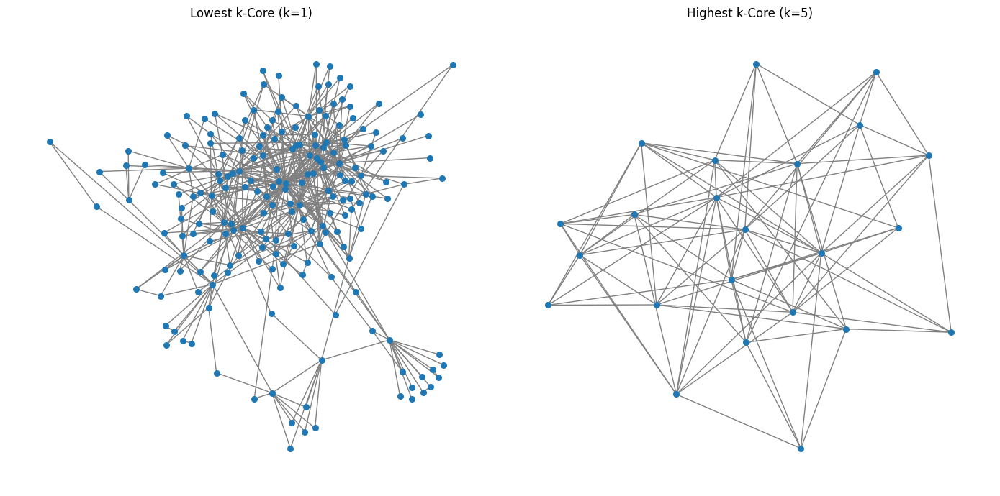

In [ ]:
# Code to prove our answer as we want to compare the two extremes, the minimum and the maximum to see how k impacts on it.

# Extract k-core subgraphs
low_k_core = nx.k_core(graf, k_min)
high_k_core = nx.k_core(graf, k_max)

# Compute average clustering coefficients
low_k_clustering = nx.average_clustering(low_k_core)
high_k_clustering = nx.average_clustering(high_k_core)

print(f"Average Clustering Coefficient for Lowest k-Core (k={k_min}): {low_k_clustering:.4f}")
print(f"Average Clustering Coefficient for Highest k-Core (k={k_max}): {high_k_clustering:.4f}")

# Plot side-by-side
plt.figure(figsize=(14, 7))

plt.subplot(1, 2, 1)
nx.draw_networkx(low_k_core, node_size=30, edge_color='gray', with_labels=False)
plt.title(f"Lowest k-Core (k={k_min})")
plt.axis('off')

plt.subplot(1, 2, 2)
nx.draw_networkx(high_k_core, node_size=30, edge_color='gray', with_labels=False)
plt.title(f"Highest k-Core (k={k_max})")
plt.axis('off')

plt.tight_layout()
plt.show()



---

The parameter `k` in a k-core is indirectly related to the average clustering coefficient (as we can see above). As we know, a k-core is a maximal subgraph where every node has at least degree `k`. Therefore, as `k` increases nodes with lower degrees are progressively removed, as a consequence, the structures that remain become denser.

Because of this, we can say that there is indeed a relation, in which, as `k` increases the subgraph becomes more interconnected. As we can see in the plot above, where the number of triangles is much larger in the k-core with k=5 than in the k-core with k=1.

---


# **UNIT 8 - DIFFUSION / LABEL PROPAGATION**

In these exercises we will analyze the spread of Covid for around 400 days since January 1, 2020. The data we obtained at the beginning are taken from public data on the impact by province.

Some provinces do not have a single name, so there are certain difficulties when aggregating the data.
We create a dictionary of synomyms.

In [ ]:
sinonims = {"Castelló": "Castellón / Castelló", "Bizkaia": "Vizcaya / Bizkaia", "Illes Balears": "Baleares / Balears", 'Alacant': "Alicante",
           'València': "Valencia / València", "Gipuzcoa": "Guipúzcoa / Gipuzkoa", "Araba": "Álava", "Girona": "Gerona / Girona", "Ourense": "Orense / Ourense",
           "A Coruña": "La Coruña / A Coruña", "Navarra": "Navarra / Nafarroa", "Lleida": "Lérida / Lleida", }

This function allows us to visualize the map of Spain with the respective nodes and edges according to its provincial borders.
We can add the variable ```nCases = 1``` if our graph has the parameter _numero_casos_

In [ ]:
def visualize_map(graph, nCases = 0):
    filepath = "provincias-espanolas.geojson"
    spanish_regions = geopandas.read_file(filepath)
    centroids = np.column_stack((spanish_regions.centroid.x, spanish_regions.centroid.y))
    queen = weights.Queen.from_dataframe(spanish_regions)

    positions = dict(zip(graph.nodes, centroids))

    if not nCases:
        ax = spanish_regions.plot(linewidth=1, edgecolor="grey", facecolor="lightblue")
        ax.axis("image")
        ax.axis("off")
        nx.draw(graph, positions, labels = {x[0]: graph.nodes.data()[x[0]]['nom'] for x in graph.nodes.data()}, ax=ax, node_size=5, node_color="r", with_labels=0)
        plt.show()

        return None
    ax = spanish_regions.plot(linewidth=1, edgecolor="grey", facecolor="lightblue")
    ax.axis("image")
    ax.axis("off")
    nSize = {x[0]: graph.nodes.data()[x[0]]['num_casos'] for x in graph.nodes.data()}
    minimum, maximum = min(nSize.values()),max(nSize.values())
    nx.draw(graph, positions, labels = {x[0]: graph.nodes.data()[x[0]]['nom'] for x in graph.nodes.data()}, node_size = [int(100*(nSize[x] - minimum)/((maximum - minimum) if minimum != maximum else 1)) for x in nSize] , ax=ax, node_color="r", with_labels=0)
    plt.show()

    return None

In [ ]:
graph = nx.read_graphml('graph.ml')
casos_diarios = pd.read_csv('./casos_diagnostico_provincia.csv')
table = pd.read_csv('./translate_clean.csv')

For convenience and compatibility with the aggregate of the data, from different sources, we will ignore the autonomous cities:

In [ ]:
for provincia in [graph.nodes.data()[x[0]]['nom'] for x in graph.nodes.data()]:
    if not provincia in table['nom'].to_list():
        if not provincia in sinonims:
            print(provincia)
        elif not sinonims[provincia] in table['nom'].to_list():
            print(provincia)

Melilla
Ceuta


In [ ]:
samples = casos_diarios.fecha.unique()
graphs = []

In [ ]:
nodes = [graph.nodes.data()[x[0]]['nom'] for x in graph.nodes.data()]
dict_code = {}
for n, node in enumerate(nodes):
    node2=node
    if node in ['Ceuta', 'Melilla']: continue
    if node in sinonims:
        node2 = sinonims[node]
    dict_code[node] = table[table['nom'] == node2]['codi'].to_list()[0]

name2number = {graph.nodes.data()[x[0]]['nom']: x[0] for x in graph.nodes.data()}
print("Codes of the provinces:\n\t",dict_code)
for day in samples:
    graph_copia = copy.deepcopy(graph)
    casos_sampled = casos_diarios[casos_diarios['fecha'] == day]
    data_to_insert = {}
    for provincia in dict_code:
        try:
            casos = casos_sampled[casos_sampled['provincia_iso'] == dict_code[provincia]]['num_casos'].to_list()[0]
        except:
            casos = 0

        data_to_insert[name2number[provincia]] = casos
    data_to_insert[name2number['Ceuta']] = 0
    data_to_insert[name2number['Melilla']] = 0
    nx.set_node_attributes(graph_copia, data_to_insert, name = 'num_casos')

    graphs.append(graph_copia)



Codes of the provinces:
	 {'Castelló': 'CS', 'Huelva': 'H', 'Santa Cruz de Tenerife': 'TF', 'Palencia': 'P', 'Guadalajara': 'GU', 'Segovia': 'SG', 'Zamora': 'ZA', 'Madrid': 'M', 'Cantabria': 'S', 'Bizkaia': 'BI', 'Badajoz': 'BA', 'Huesca': 'HU', 'Lugo': 'LU', 'Soria': 'SO', 'Toledo': 'TO', 'Illes Balears': 'PM', 'Navarra': nan, 'Alacant': 'A', 'Murcia': 'MU', 'Albacete': 'AB', 'Cáceres': 'CC', 'Ciudad Real': 'CR', 'Lleida': 'L', 'Ávila': 'AV', 'Cádiz': 'CA', 'València': 'V', 'Barcelona': 'B', 'Cuenca': 'CU', 'Burgos': 'BU', 'Gipuzcoa': 'SS', 'Salamanca': 'SA', 'Sevilla': 'SE', 'Valladolid': 'VA', 'Jaén': 'J', 'Córdoba': 'CO', 'León': 'LE', 'Araba': 'VI', 'Girona': 'GI', 'Málaga': 'MA', 'Ourense': 'OR', 'Tarragona': 'T', 'Almería': 'AL', 'Granada': 'GR', 'La Rioja': 'LO', 'Las Palmas': 'GC', 'Pontevedra': 'PO', 'A Coruña': 'C', 'Teruel': 'TE', 'Zaragoza': 'Z', 'Asturias': 'O'}


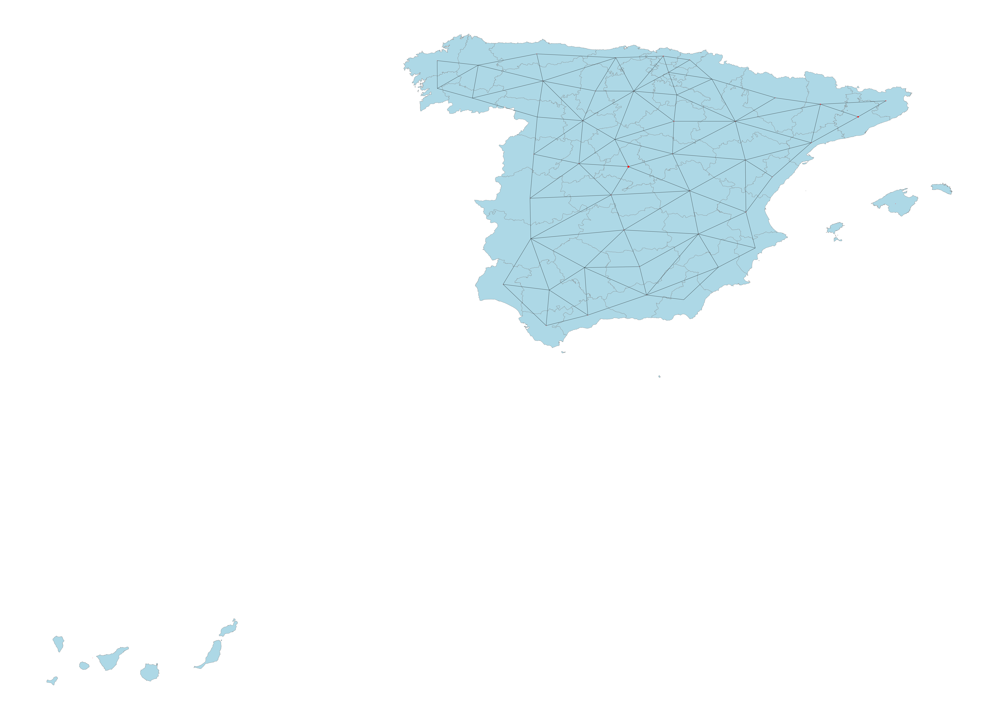

In [ ]:
#%matplotlib qt
visualize_map(graphs[151], nCases=True)


# EXERCISES TO SOLVE
* You have to answer the sections that start with a **bullet point**.

----

## Diffusion and propagation
In the `graphs` variable we have a list of the state of covid in terms of the number of people affected by province.

In general, the contagion at a given node (transmission) in a SIR (Susceptible, Infected, Recovered) model depends on the number of neighbors (contacts) that are infected (interaction rate), and the probability of contagion. See the following figure taken from the class notes with the equation for the increase in contagions for an aggregate calculation case.


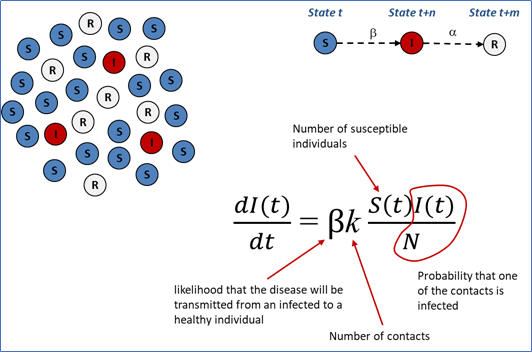

In our case, the nodes have the value of the infected people at the corresponding province at the instant *t* and the edges indicate the neighborhood (we will assume that the contagion occurs between neighboring provinces and with the intensity of the corresponding infected values) . For this we must define a transmission function, which will always depend on an aggregate of the values of the neighboring nodes.

Let's define a simple approximation to the transmission function between nodes iassuming that the next state of the node is the sum of the incoming nodes multiplied by a coefficient, according to the following equation:

# $n = \theta*(n + \sum n^{in}_{i} )$


In order to make less noisy predictions, one option is to calculate this coefficient as the average of the coefficients in a certain time window.
For example if we want to predict day 5, we will calculate the coefficient of day 1-2, 2-3... and assign the average of these values.

* Complete the function ```aproximació_coeficient_de_transmissió``` so it returns a dictionary ```{province: coefficient}```

---
To complete the function and calculate an approximation of the transmission coefficient we will use the formula above in the following way:

#$\theta = \frac{n_{t+1}}{n_t + \sum_i n_i^{\text{in}}}$

Where:
> $n_{t+1}$ is the number of infected people in the province on day $t+1$.

> $n_t$ is the number of infected people in the province on day $t$.

> $\sum_i n_i^{\text{in}}$ is the sum of infected people in the neighboring provinces on day $t$.

We will compute the coefficients of the number of days specified by the window size for every province, and then average the results by summing them, dividing by the total number of coefficients (of that province) and adding it to the dictionary.

---

In [ ]:
# ANSWER

def aproximació_coeficient_de_transmissió(grafs, mida_finestra, element_a_predir, lut = name2number):
    '''
    grafs: graphs list
    mida_finestra: number of previous graphs to compute the average
    element_a_predir: graph index to predict
    lut: look up table to get data from name to number

    returns:
        coeficients: Dictionary with the transmission coefficient of each province
    '''
    assert mida_finestra < element_a_predir, f"We can not compute a window {mida_finestra} days older than the selected item"
    coeficients = {}

    provinces = grafs[0].nodes()

    for prov in provinces:
      coefficient_vals = []
      for i in range(element_a_predir - mida_finestra, element_a_predir):
        # Get the graphs at time step t and t+1
        g_prev = grafs[i]
        g_next = grafs[i+1]

        # Obtain the number of infected people in the province on day t and t+1
        n_t = g_prev.nodes[prov].get('num_casos', 0)
        n_t1 = g_next.nodes[prov].get('num_casos', 0)

        # Sum of infected at time t
        neighbor_sum = sum(g_prev.nodes[neigh].get('num_casos', 0) for neigh in g_prev.neighbors(prov))
        denominator = n_t + neighbor_sum

        if denominator > 0:
          theta = n_t1 / denominator
          coefficient_vals.append(theta)
        else:
          coefficient_vals.append(0)

        # Average theta over the time window
        coeficients[prov] = sum(coefficient_vals) / len(coefficient_vals) if coefficient_vals else 0.0

    return coeficients

In [ ]:
coeficients = aproximació_coeficient_de_transmissió(graphs, 5, 300) # Using the function

From this we can get some interesting visualizations, such as the average coefficient throughout the year:
* Visualize the evolution plot of the coefficient average throughout the year.

In [ ]:
# ANSWER

avg_coeficient = []

# Define a window size
mida_finestra = 5

# Iterate through the days
for t in range(mida_finestra+1, len(graphs)-1):
  # Compute the coefficients in the different provinces during day t
  coef = aproximació_coeficient_de_transmissió(graphs, mida_finestra, t)

  # Compute the average of coefficients for day t
  avg = sum(coef.values()) / len(coef)
  avg_coeficient.append(avg)

In [ ]:
plt.plot(avg_coeficient)
plt.show()

Since the data was grouped weekly, the result is quite noisy. When we have a signal with a lot of variance at the local level we can use a smoothing by [convolution](https://en.wikipedia.org/wiki/Smoothing):

In [ ]:
# Smoothing by convolution
ksize = 3
avg_smoothed = [sum(avg_coeficient[max(i-ksize, 0):min(i+ksize, len(avg_coeficient))])/(ksize*2) for i in range(len(avg_coeficient))]

In [ ]:
plt.plot(avg_smoothed)
plt.show()

* What conclusions can you draw from this visualization? What do the inflexion points mean?

Write the **answer**:

> By looking at the plot we can see that, initially, there is a steep increase in the average transmission coefficient. This is consistent with epidemiological models, where the disease spread goes through different phases.
 In the early phases, when the epidemic is just starting and no measures are being taken, transmission is very rapid, leading to high coefficients, corresponding to the first steep peak that we see in the plot.

> As the epidemic progresses, the adoption of measures as well as changes in the population behavior can slow transmission, causing the first inflexion point. Where the transmission coefficient decreases notably.

> Through the rest of the plot we can continue to see many fluctuations with other inflection points (even though they are not as severe as the first one), until finally, at the end of the year, the transmission coefficient drops, indicating the disease elimination or the decrease in the contagion of the disease.

 > The inflection points often correspond to the transitions from one phase of the pandemic or epidemic to another phase. They can be caused by interventions, such as the use of masks, social distancing etc. Usually indicating the effect of the introduced measures. They can also be influenced by external events like a super-spreader event, a significant change in population mobility, or other socio-economic factors that can alter the infection rate.

With this model we can make very simple predictions to know the infection rate of the day after a graph at the time *t*.
* Complete the function `predict()` so it fills a dictionary of results with the different predictions.
> GT (Ground Truth): The subsequent graph of the original data to the current graph can be used to calculate the error.

In [ ]:
def predict(graf, coeficients, GT = None, lut = name2number):
    '''
    graf: graph on which we want to predict the next iteration
    coeficients: transmission coefficients dictionary corresponding to the nodes (provinces)
    GT: Groundtruth, It would correspond to the actual values of the prediction, so we can calculate the error.
        For xample, we can make the prediction of day 150 from the previous 149, and compare with the actual 150.
    lut: look up table to retrieve data from name to number (name2number ehas been created previously)
    '''
    results = {}
    prediccions = {}

    for prov in graf.nodes():
        n_t = graf.nodes[prov].get('num_casos', 0)
        neighbor_sum = sum(graf.nodes[neigh].get('num_casos', 0) for neigh in graf.neighbors(prov))
        theta = coeficients.get(prov, 0)

        # Apply transmission model
        n_pred = theta * (n_t + neighbor_sum)
        prediccions[prov] = n_pred

    results['predicted'] = prediccions

    if GT:
        gt = {x: GT.nodes[x]['num_casos'] for x in prediccions}
        error = {x: gt[x] - prediccions[x] for x in prediccions}
        avg_error = sum(abs(e) for e in error.values()) / len(error)
        sum_errors = sum(abs(e) for e in error.values())

        results['avg_error'] = avg_error
        results['sum_errors'] = sum_errors
        results['error'] = error
        results['ground_truth'] = gt

    return results

Example of calls to the functions **`coeficients`** and **`predict`**

In [ ]:
coeficients = aproximació_coeficient_de_transmissió(graphs, 5, 300)

In [ ]:
prediccions = predict(graphs[299], coeficients, graphs[300])

In [ ]:
prediccions['predicted'][name2number['Tarragona']], graphs[300].nodes[name2number['Tarragona']]['num_casos']

(577.8358563205171, 590)

* If we were at day 150; what number of total cases do you estimate for day 151?


In [ ]:
# ANSWER
# mida_finestra= How many days back we look to compute the average transmission coefficient
# We want a good balance between accuracy and stability.

element_a_predir = 150
# We're at day 150 and want to predict day 151

coeficients = aproximació_coeficient_de_transmissió(graphs, mida_finestra, element_a_predir)

# Predict infections for day 151
graf_t = graphs[element_a_predir]
graf_t1 = graphs[element_a_predir + 1]  # Ground truth for error comparison

results = predict(graf_t, coeficients, GT=graf_t1)

# Report total estimated and actual cases
total_predicted = sum(results['predicted'].values())
total_actual = sum(nx.get_node_attributes(graf_t1, 'num_casos').values())



In [ ]:
# Compute accuracy
accuracy = 1 - abs(total_predicted - total_actual) / total_actual

# Print results
print("Estimated total cases for day 151:", total_predicted)
print("Actual total cases on day 151:", total_actual)
print("Prediction accuracy:", accuracy)

Estimated total cases for day 151: 306.6224025981447
Actual total cases on day 151: 239
Prediction accuracy: 0.7170610769952106


* How can we improve the model?

Write the **answer**:

>We can improve the model by letting the transmission rate (θ) change over time. Right now it's fixed, but real situations like lockdowns or holidays affect how the virus spreads.

>We could also use a different θ for each province. Some places are more crowded or connected, so they might need their own transmission rate.

>Another idea is to give more weight to certain neighbors. Not all neighboring provinces have the same impact as some are more connected than others.

>We should also include recovery. Right now we only track infections, but people eventually recover, and our model should show that. In our model, once someone is infected, they stay infected forever which isn’t realistic.

>It also doesn’t allow people to get infected again. A better approach would be to use something like the SIR model (Susceptible, Infected, Recovered), where each person can move between states depending on their situation. In the SIR model, the number of new infections depends on how many infected neighbors a person has and the probability of catching the disease from them.

>Finally, we could try using a simple machine learning model to help find patterns and improve our predictions.



Finally, even though the model is simple, it is important to be able to make decisions and evaluate them. In this case, the decision will aim to minimize the spread of the virus:

* Which set of 5 provinces would you confine the day 300 to minimize contagion to the rest?
* How much has the impact of the virus decreased the day 310 after confining these provinces?
>(hint: calculate predictions in the future time and compare them to the actual data of the day)


 > The provinces to confine should be those with the highest prediction of cases looking at day 301. This is based on the assumption that these provinces will contribute the most to the virus's spread in the following days. Therefore, we will compute the predictions and select the 5 provinces with more predicted cases.

In [ ]:
# ANSWER

# Choose provinces to confine
coeficients = aproximació_coeficient_de_transmissió(graphs, 5, 300)
pred_day_301 = predict(graphs[300], coeficients, graphs[301])
# Select 5 first provinces
top5_provinces = sorted(pred_day_301['predicted'], key=pred_day_301['predicted'].get, reverse=True)[:5]
# Define a lut to go from numbers to names
number2name = {v: k for k, v in name2number.items()}

prov_names = []
for prov in top5_provinces:
  prov_names.append(number2name[prov])
# Show the names of the 5 provinces to confine
print("List of provinces to confine the day 300:", prov_names)

List of provinces to confine the day 300: ['Barcelona', 'Madrid', 'Sevilla', 'Granada', 'València']


Now we will define a function to simulate both possible cases, and see the impact that confinating those 5 provinces (Barcelona, Madrid, Sevilla, Granada and Valènica) has had.

In [ ]:
# Define a function to simulate both scenarions
def simulate_future(graphs, coef, confined_provinces, start_day=300, end_day=310):
    current_graph = copy.deepcopy(graphs[start_day])
    results_by_day = {}

    for day in range(start_day+1, end_day+1):
        pred = predict(current_graph, coef)['predicted']
        results_by_day[day] = pred

        # Prepare next day's graph
        next_graph = copy.deepcopy(current_graph)
        for prov, cases in pred.items():
            if prov in confined_provinces:
                next_graph.nodes[prov]['num_casos'] = 0
            else:
                next_graph.nodes[prov]['num_casos'] = cases

        current_graph = next_graph

    return results_by_day

# Simulate both cases
normal = simulate_future(graphs, coeficients, confined_provinces=[], start_day=300, end_day=310) # no confinement
confined = simulate_future(graphs, coeficients, confined_provinces=top5_provinces, start_day=300, end_day=310) # confinement

# Compare totals on day 310
total_normal = sum(normal[310].values())
total_confined = sum(confined[310].values())

# Show results
impact_reduction = total_normal - total_confined
print(f"Impact reduction by confining {prov_names}: {int(impact_reduction)} fewer cases on day 310")
print("\n")
print(f"Number of cases on day 310 without confinement: {int(total_normal)}")
print(f"Number of cases on day 310 after confinement: {int(total_confined)}")

Impact reduction by confining ['Barcelona', 'Madrid', 'Sevilla', 'Granada', 'València']: 30543 fewer cases on day 310


Number of cases on day 310 without confinement: 39560
Number of cases on day 310 after confinement: 9016




---

After simulating both scenarios, the one in which we confine those 5 provinces and the one in which we do not, we can clearly see the efect the confinement has had. Decreasing the number of cases from 39560 to 9016. In terms of the number of contagions avoided, we can see that we have avoided more or less 30543 contagions by confining the more affected provinces.

**code details:** the function `simulate_future` simulates the spread of the virus over a given period of time, defined by `start_day`and `end_day`. It predicts the number of cases for each province on each day using our transmission model (`predict` function) and then updates the graph based on the predictions. If a province is in the `confined_provinces` list, its cases are set to zero for the day, simulating confinement.

---


